In [116]:
# for auto-reloading extenrnal modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

import trimesh
import numpy as np

from utils.show_mesh import *
from utils.visualization_tool import *

from utils.symmetry_vect import *
from utils.curvature import *
from utils.HKS import *

import torch
import numpy as np
from pytorch3d.io import load_obj, save_obj
from pytorch3d.structures import Meshes
from pytorch3d.utils import ico_sphere
from pytorch3d.ops import sample_points_from_meshes
from pytorch3d.loss import (
    chamfer_distance, 
    mesh_edge_loss, 
    mesh_laplacian_smoothing, 
    mesh_normal_consistency,
)

from tqdm.notebook import tqdm
%matplotlib notebook 
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['savefig.dpi'] = 80
mpl.rcParams['figure.dpi'] = 80


# Set the device
if torch.cuda.is_available():
    device = torch.device("cuda:0")
else:
    device = torch.device("cpu")
    print("WARNING: CPU only, this will be slow!")

%pylab inline
%config InlineBackend.figure_format = 'svg'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


/opt/homebrew/anaconda3/envs/test/lib/python3.9/site-packages/IPython/core/magics/pylab.py:162: UserWarning:

pylab import has clobbered these variables: ['Annotation', 'scatter', 'box', 'table', 'histogram', 'bar', 'pie', 'Figure', 'histogram2d', 'plot', 'contour']
`%matplotlib` prevents importing * from pylab and numpy



In [117]:
mesh = trimesh.load('meshes/milk_carton/milk_carton.obj', file_type="obj", force='mesh')
mesh.export('meshes/milk_carton2/test2.obj')

mesh.visual = mesh.visual.to_color()
mesh.visual.face_color = []
mesh.vertices -= mesh.center_mass
mesh.show()

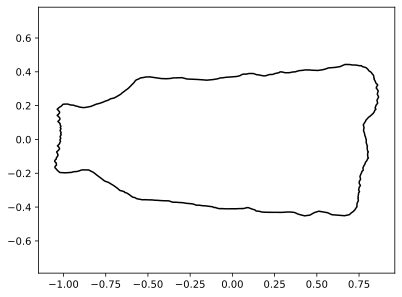

In [118]:
# view section plane through the origin
slice = mesh.section(plane_origin=mesh.centroid,
                     plane_normal=[0,1,0])
slice_2D, to_3D = slice.to_planar()
slice_2D.show()

[[-0.45083835 -0.50781069 -0.93194288]
 [ 0.48424915  0.49760761  1.15853017]]
[-0.50781069  0.49760761]


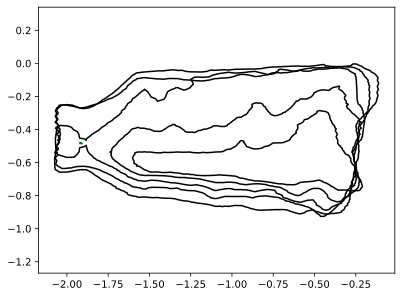

In [119]:
# view section multiplanes

print(mesh.bounds)
y_extents = mesh.bounds[:,1]
# slice every .125 model units (eg, inches)
y_levels  = np.arange(*y_extents, step=.1)
# find a bunch of parallel cross sections
print(y_extents)
sections = mesh.section_multiplane(plane_origin=mesh.bounds[0],
                                   plane_normal=[0,1,0],
                                   heights=y_levels)
# remove all NoneType in sections
sections = [x for x in sections if x is not None]
combined = np.sum(sections)
combined.show()

In [120]:
def createPlane(width, height, normal):
    # Normalize the normal vector
    normal = normal / np.linalg.norm(normal)
    
    # Define the vertices for a rectangle in the XY plane, centered at the origin
    vertices = np.array([
        [-width / 2, -height / 2, 0],
        [ width / 2, -height / 2, 0],
        [ width / 2,  height / 2, 0],
        [-width / 2,  height / 2, 0]
    ])
    
    # Define the faces of the rectangle
    faces = np.array([
		[0, 1, 2],
		[0, 2, 3],
		[2, 1, 0],
		[3, 2, 0]
	])
    
    # Create a mesh for the rectangle
    plane_mesh = trimesh.Trimesh(vertices=vertices, faces=faces)
    
    # Check if the normal is already [0, 0, 1] or [0, 0, -1]
    if not np.allclose(normal, [0, 0, 1]) and not np.allclose(normal, [0, 0, -1]):
        # The normal is not aligned with the Z-axis, calculate the rotation
        axis_to_align = [0, 0, 1]
        direction = np.cross(axis_to_align, normal)
        angle = np.arccos(np.clip(np.dot(axis_to_align, normal), -1.0, 1.0))

        # Use trimesh's rotation_matrix to create a 4x4 transformation matrix
        rotation_matrix = trimesh.transformations.rotation_matrix(angle, direction, point=[0, 0, 0])
        
        # Apply the transformation to the mesh
        plane_mesh.apply_transform(rotation_matrix)
    elif np.allclose(normal, [0, 0, -1]):
        # The normal is directly opposite to the Z-axis, rotate 180 degrees around the Y-axis
        rotation_matrix = trimesh.transformations.rotation_matrix(np.pi, [0, 1, 0], point=[0, 0, 0])
        plane_mesh.apply_transform(rotation_matrix)
    
    return plane_mesh

In [121]:
def closest_point_on_plane(plane_mesh, random_vertex): # returns closest point and distance to that point
    # Assume the normal is the Z-axis since the plane was created aligned with the XY plane
    # If the plane has been transformed, then the normal needs to be transformed as well
    normal = plane_mesh.face_normals[0]  # Using the normal of the first face

    # Any vertex on the plane can serve as Q
    point_on_plane = plane_mesh.vertices[0]

    # Compute the vector from the point on the plane to the random vertex
    vector_to_vertex = random_vertex - point_on_plane

    # Project this vector onto the normal vector (dot product)
    distance_along_normal = np.dot(vector_to_vertex, normal)

    # Subtract the component that is parallel to the normal to find the closest point
    closest_point = random_vertex - distance_along_normal * normal

    return (closest_point, distance_along_normal)

In [122]:
def find_closest_point(mesh, point): # Function to find the closest point on the mesh
    # Calculate the distance between the point and all vertices in the mesh
    distances = np.linalg.norm(mesh.vertices - point, axis=1)
    # Find the index of the closest vertex
    closest_vertex_index = np.argmin(distances)
    # Return the closest vertex index
    return closest_vertex_index

In [123]:
#create symmetry planes

# Create the mesh
bottom_plane = createPlane(1.3, 1.3, [0, 0, 1]) 
bottom_plane.apply_translation((0, 0, -0.65))

symmetry1_plane = createPlane(1, 2.5, [0, 1, 0]) 
angle = 76 * np.pi / 180
rotation_axis = [0, 0, 1]  # Z-axis
center = [0, 0, 0]
rot_matrix = trimesh.transformations.rotation_matrix(angle, rotation_axis, center)
symmetry1_plane.apply_transform(rot_matrix)
side1_plane = symmetry1_plane.copy().apply_translation((-0.35, 0, 0))
side3_plane = symmetry1_plane.copy().apply_translation((0.35, 0, 0))

symmetry2_plane = createPlane(1, 2.5, [0, 1, 0]) 
angle = -14 * np.pi / 180
rotation_axis = [0, 0, 1]  # Z-axis
center = [0, 0, 0]
rot_matrix = trimesh.transformations.rotation_matrix(angle, rotation_axis, center)
symmetry2_plane.apply_transform(rot_matrix)
side2_plane = symmetry2_plane.copy().apply_translation((0, 0.32, 0))
side4_plane = symmetry2_plane.copy().apply_translation((0, -0.32, 0))

symmetry3_plane = createPlane(1, 2.5, [0, 1, 0])
angle = 31 * np.pi / 180
rotation_axis = [0, 0, 1]  # Z-axis
center = [0, 0, 0]
rot_matrix = trimesh.transformations.rotation_matrix(angle, rotation_axis, center)
symmetry3_plane.apply_transform(rot_matrix)

# Visualize the mesh
scene = trimesh.Scene([mesh, bottom_plane, side1_plane, side3_plane, side2_plane, side4_plane])
scene.show()



In [124]:
mesh_fixed = mesh.copy()
for i in range(len(mesh_fixed.vertices)):
	point_on_bottom_plane, dist_to_bottom_plane = closest_point_on_plane(bottom_plane, mesh_fixed.vertices[i])

	if(dist_to_bottom_plane < 0):
		mesh_fixed.vertices[i] = point_on_bottom_plane

	point_on_side1_plane, dist_to_side1_plane = closest_point_on_plane(side1_plane, mesh_fixed.vertices[i])
	point_on_side3_plane, dist_to_side3_plane = closest_point_on_plane(side3_plane, mesh_fixed.vertices[i])

	if(dist_to_side1_plane > 0):
		mesh_fixed.vertices[i] = point_on_side1_plane

	if(dist_to_side3_plane < 0.01):
		mesh_fixed.vertices[i] = point_on_side3_plane

	point_on_side2_plane, dist_to_side2_plane = closest_point_on_plane(side2_plane, mesh_fixed.vertices[i])
	point_on_side4_plane, dist_to_side4_plane = closest_point_on_plane(side4_plane, mesh_fixed.vertices[i])
	
	if(dist_to_side2_plane > 0):
		mesh_fixed.vertices[i] = point_on_side2_plane
	
	if(dist_to_side4_plane < 0):
		mesh_fixed.vertices[i] = point_on_side4_plane
	

mesh_fixed.show()


In [125]:
region_growing_pct = trimesh.PointCloud(mesh.vertices)
scene = trimesh.Scene([region_growing_pct, symmetry1_plane, symmetry3_plane, symmetry2_plane, bottom_plane])
scene.show()

In [126]:
def reflect_across_plane_1(vertice):
	point_on_plane_1, dist_to_plane_1 = closest_point_on_plane(symmetry1_plane, vertice)
	coordinate_reflection_across_plane_1 = 2 * point_on_plane_1 - vertice
	return coordinate_reflection_across_plane_1

def reflect_across_plane_2(vertice):
	point_on_plane_2, dist_to_plane_2 = closest_point_on_plane(symmetry2_plane, vertice)
	coordinate_reflection_across_plane_2 = 2 * point_on_plane_2 - vertice
	return coordinate_reflection_across_plane_2

def reflect_across_plane_3(vertice):
	point_on_plane_3, dist_to_plane_3 = closest_point_on_plane(symmetry3_plane, vertice)
	coordinate_reflection_across_plane_3 = 2 * point_on_plane_3 - vertice
	return coordinate_reflection_across_plane_3

symmetries = [reflect_across_plane_1, reflect_across_plane_2, reflect_across_plane_3]
num_symmetries = len(symmetries)


In [127]:
def plot_pointcloud(mesh, title=""):
    # Sample points uniformly from the surface of the mesh.
    points = sample_points_from_meshes(mesh, 5000)
    x, y, z = points.clone().detach().cpu().squeeze().unbind(1)    
    fig = plt.figure(figsize=(5, 5))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter3D(x, z, -y)
    ax.set_xlabel('x')
    ax.set_ylabel('z')
    ax.set_zlabel('y')
    ax.set_title(title)
    ax.view_init(190, 30)
    plt.show()

In [128]:
region_growing_pct = trimesh.PointCloud(mesh.vertices)
newVertices = []
for vertice in region_growing_pct.vertices:
	coordinate_reflection_across_plane_1 = reflect_across_plane_1(vertice)
	coordinate_reflection_across_plane_2 = reflect_across_plane_2(vertice)
	coordinate_reflection_across_plane_3 = reflect_across_plane_3(vertice)
	newVertices.append(coordinate_reflection_across_plane_1)
	newVertices.append(coordinate_reflection_across_plane_2)
	newVertices.append(coordinate_reflection_across_plane_3)

newVertices = np.array(newVertices)
# add newVertices to region_growing_mesh
region_growing_pct.vertices = np.concatenate((region_growing_pct.vertices, newVertices))
scene = trimesh.Scene([region_growing_pct, symmetry1_plane, symmetry2_plane, symmetry3_plane, bottom_plane])
scene.show()

In [129]:
def getTensorFromNumpyVertices(numpyVertices):
	tensor = torch.tensor(numpyVertices, dtype=torch.float32, device=device)
	for i in range(1, numpyVertices.shape[0]//10000):
		temp = torch.tensor(numpyVertices[i*10000:min((i+1)*10000, numpyVertices.shape[0])], dtype=torch.float32, device=device)
		print(temp.shape)
		tensor = torch.cat((tensor, temp), 0)
		print(tensor.shape)
	return tensor

In [130]:
sample_points = 1000
Niter = 1000

mesh_vertices_tensor = torch.unsqueeze(torch.tensor(mesh.vertices, dtype=torch.float32, device=device), dim=0)
deform_verts = torch.full(mesh_vertices_tensor.shape, 0.0, dtype=torch.float32, device=device, requires_grad=True)
optimizer = torch.optim.SGD([deform_verts], lr=1.0, momentum=0.9)

losses = []

for i in range(Niter):
    # Initialize optimizer
    optimizer.zero_grad()

    new_mesh_vertices_tensor = mesh_vertices_tensor + deform_verts
    
    random_sample_indices = np.random.choice(mesh.vertices.shape[0], size=sample_points, replace=False)
    random_sample_vertices = mesh.vertices[random_sample_indices, :]
    random_sample_reflect_vertices = np.array([symmetries[np.random.choice(num_symmetries)](mesh.vertices[i]) for i in random_sample_indices])
    random_sample_reflect_vertices_tensor = torch.unsqueeze(torch.tensor(random_sample_reflect_vertices, dtype=torch.float32, device=device), dim=0)
    
    # We compare the two sets of pointclouds by computing (a) the chamfer loss
    loss_chamfer, _ = chamfer_distance(random_sample_reflect_vertices_tensor, new_mesh_vertices_tensor)
    
    # Weighted sum of the losses
    loss = loss_chamfer
    losses.append(loss)
    
    if(i % 100 == 0):
        print(f'total_loss = {loss}')
        
    # Optimization step
    loss.backward()
    optimizer.step()

total_loss = 0.005416359752416611
total_loss = 0.003843866055831313
total_loss = 0.003609579289332032
total_loss = 0.0035330564714968204
total_loss = 0.0033137875143438578
total_loss = 0.003214021446183324
total_loss = 0.003147087525576353
total_loss = 0.0030880440026521683
total_loss = 0.00311828195117414
total_loss = 0.0029375068843364716


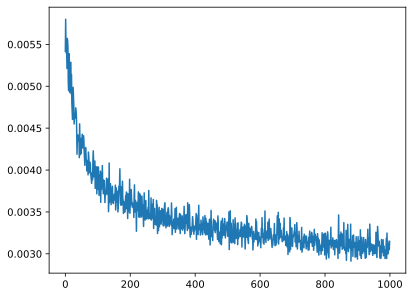

In [133]:
import matplotlib.pyplot as plt
losses_print = [loss.detach().cpu().numpy() for loss in losses]
y = np.arange(0, Niter, 1)
plt.plot(y, losses_print)

In [134]:
sample_points = 1000
Niter = 1000

mesh_vertices_tensor = torch.unsqueeze(torch.tensor(mesh.vertices, dtype=torch.float32, device=device), dim=0)
deform_verts = torch.full(mesh_vertices_tensor.shape, 0.0, dtype=torch.float32, device=device, requires_grad=True)
optimizer = torch.optim.Adam([deform_verts], lr=0.1)

losses = []

for i in range(Niter):
    # Initialize optimizer
    optimizer.zero_grad()

    new_mesh_vertices_tensor = mesh_vertices_tensor + deform_verts
    
    random_sample_indices = np.random.choice(mesh.vertices.shape[0], size=sample_points, replace=False)
    random_sample_vertices = mesh.vertices[random_sample_indices, :]
    random_sample_reflect_vertices = np.array([symmetries[np.random.choice(num_symmetries)](mesh.vertices[i]) for i in random_sample_indices])
    random_sample_reflect_vertices_tensor = torch.unsqueeze(torch.tensor(random_sample_reflect_vertices, dtype=torch.float32, device=device), dim=0)
    
    # We compare the two sets of pointclouds by computing (a) the chamfer loss
    loss_chamfer, _ = chamfer_distance(random_sample_reflect_vertices_tensor, new_mesh_vertices_tensor)
    
    # Weighted sum of the losses
    loss = loss_chamfer
    losses.append(loss.detach().cpu().numpy())
    
    if(i % 100 == 0):
        print(f'total_loss = {loss}')
        
    # Optimization step
    loss.backward()
    optimizer.step()

total_loss = 0.005599619820713997
total_loss = 0.005024249199777842
total_loss = 0.0051764026284217834
total_loss = 0.0055127316154539585
total_loss = 0.005612421315163374
total_loss = 0.005592414643615484
total_loss = 0.00574716180562973
total_loss = 0.005535461474210024
total_loss = 0.005738024599850178
total_loss = 0.005696865729987621


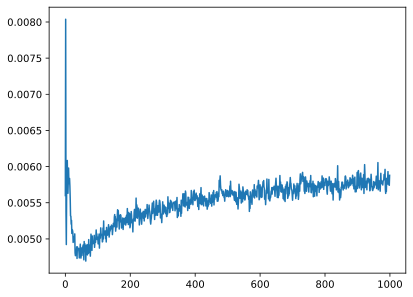

In [135]:
import matplotlib.pyplot as plt
y = np.arange(0, Niter, 1)
plt.plot(y, losses_print)

In [136]:
optimization_pct = trimesh.PointCloud(torch.squeeze(mesh_vertices_tensor + deform_verts).detach().cpu().numpy())
optimization_mesh = mesh.copy()
optimization_mesh.vertices = torch.squeeze(mesh_vertices_tensor + deform_verts).detach().cpu().numpy()
scene = trimesh.Scene([optimization_mesh, symmetry1_plane, symmetry2_plane, bottom_plane])
scene.show()

In [57]:
verts, faces, aux = load_obj('meshes/milk_carton2/test2.obj')
faces_idx = faces.verts_idx.to(device)
verts = verts.to(device)
center = verts.mean(0)
verts = verts - center
scale = max(verts.abs().max(0)[0])
verts = verts / scale
original_mesh_verts_numpy = verts.detach().cpu().numpy()
src_mesh = Meshes(verts=[verts], faces=[faces_idx])



An exception occurred in telemetry logging.Disabling telemetry to prevent further exceptions.
Traceback (most recent call last):
  File "/opt/homebrew/anaconda3/envs/test/lib/python3.9/site-packages/iopath/common/file_io.py", line 946, in __log_tmetry_keys
    handler.log_event()
  File "/opt/homebrew/anaconda3/envs/test/lib/python3.9/site-packages/iopath/common/event_logger.py", line 97, in log_event
    del self._evt
AttributeError: _evt


In [112]:
sample_points = 1000
Niter = 100

deform_verts = torch.full(src_mesh.verts_packed().shape, 0.0, device=device, requires_grad=True)
optimizer = torch.optim.SGD([deform_verts], lr=1, momentum=0.9)
# Weight for the chamfer loss
w_chamfer = 1.0 
# Weight for mesh edge loss
w_edge = 1.0 
# Weight for mesh normal consistency
w_normal = 0.01
# Weight for mesh laplacian smoothing
w_laplacian = 0.1
for i in range(Niter):
    # Initialize optimizer
    optimizer.zero_grad()
    # Deform the mesh
    new_src_mesh = src_mesh.offset_verts(deform_verts)
    
    random_sample_indices = np.random.choice(original_mesh_verts_numpy.shape[0], size=sample_points, replace=False)
    random_sample_vertices = original_mesh_verts_numpy[random_sample_indices, :]
    random_sample_reflect_vertices = np.array([symmetries[np.random.choice(num_symmetries)](original_mesh_verts_numpy[i]) for i in random_sample_indices])
    random_sample_reflect_vertices_tensor = torch.unsqueeze(torch.tensor(random_sample_reflect_vertices, dtype=torch.float32, device=device), dim=0)
    
    # We compare the two sets of pointclouds by computing (a) the chamfer loss
    loss_chamfer, _ = chamfer_distance(random_sample_reflect_vertices_tensor, new_src_mesh.verts_padded())

    # # and (b) the edge length of the predicted mesh
    # loss_edge = mesh_edge_loss(new_src_mesh)
    
    # # mesh normal consistency
    # loss_normal = mesh_normal_consistency(new_src_mesh)
    
    # # mesh laplacian smoothing
    # loss_laplacian = mesh_laplacian_smoothing(new_src_mesh, method="uniform")
    
    # Weighted sum of the losses
    loss = loss_chamfer * w_chamfer # + loss_edge * w_edge + loss_normal * w_normal + loss_laplacian * w_laplacian
    
    if(i % 10 == 0):
        print(f'total_loss = {loss}')
        
    # Optimization step
    loss.backward()
    optimizer.step()



total_loss = 0.003694416955113411
total_loss = 0.0037899832241237164
total_loss = 0.0035316217690706253
total_loss = 0.003280919510871172
total_loss = 0.003321855328977108
total_loss = 0.003064849879592657
total_loss = 0.0029905152041465044
total_loss = 0.0029466552659869194
total_loss = 0.002751648426055908
total_loss = 0.0026470173615962267


In [113]:
final_verts, final_faces = new_src_mesh.get_mesh_verts_faces(0)
final_verts = final_verts * scale + center
final_obj = 'final_model_5.obj'
save_obj(final_obj, final_verts, final_faces)

An exception occurred in telemetry logging.Disabling telemetry to prevent further exceptions.
Traceback (most recent call last):
  File "/opt/homebrew/anaconda3/envs/test/lib/python3.9/site-packages/iopath/common/file_io.py", line 946, in __log_tmetry_keys
    handler.log_event()
  File "/opt/homebrew/anaconda3/envs/test/lib/python3.9/site-packages/iopath/common/event_logger.py", line 97, in log_event
    del self._evt
AttributeError: _evt


In [114]:
mesh_fixed_2 = trimesh.load('final_model_5.obj', file_type="obj", force='mesh')
mesh_fixed_2.show()